In [1]:
import numpy as np
import minimg as mg
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
from utils import *
%matplotlib inline


## Калибровка

T2:
 [[ 2.14452046 -0.07589909  0.09789159]
 [ 0.09577423  1.30114204 -0.4941813 ]
 [ 0.092268   -0.26003614  1.73711922]]
T1:
 [[ 1.61007702  0.08912773 -0.00591999]
 [ 0.09393846  1.17729104 -0.52626828]
 [ 0.05396781 -0.1603709   2.57844221]]
WB: [ 7656.91471044 17138.43568846 13075.97055616]


<MinImg 5616 x 3744 x 3 real64 unallocated> is shown as <MinImg 5616 x 3744 x 3 uint8 allocated> contrasted

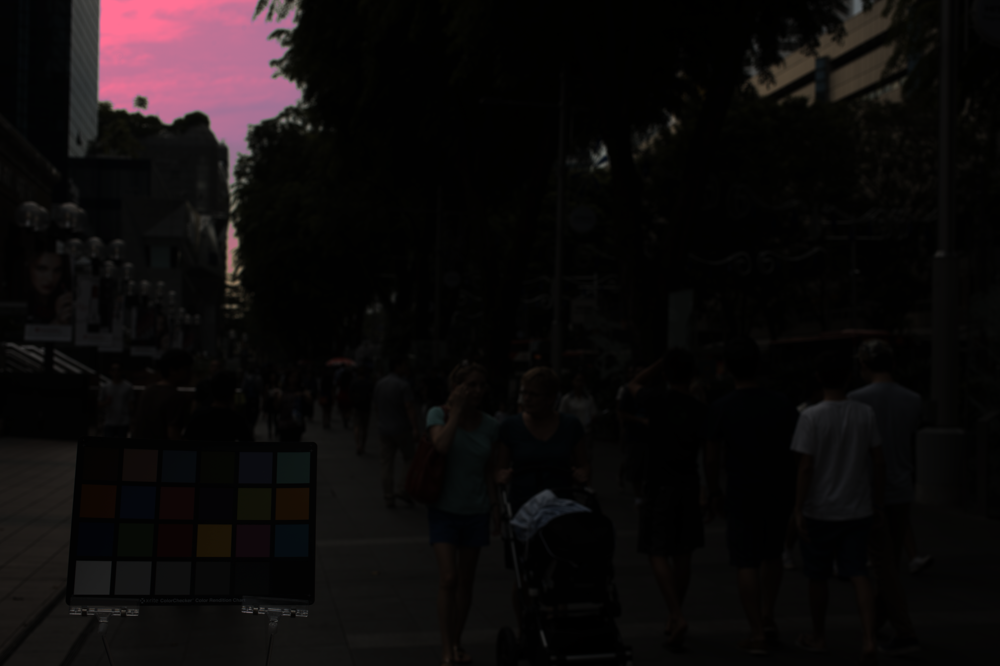

<MinImg 5616 x 3744 x 3 real64 unallocated> is shown as <MinImg 5616 x 3744 x 3 uint8 allocated> contrasted

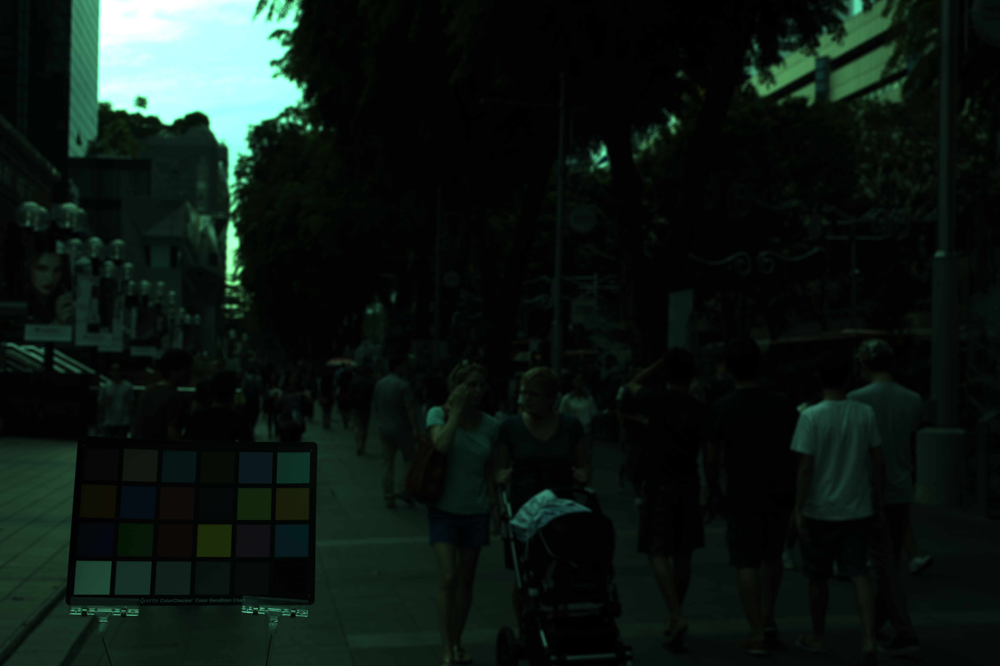

In [2]:
calimg_T2_raw = np.float64(np.asarray(mg.load("./raw tiff/raw0081.tif")))
calimg_T2_gt = np.float64(np.asarray(mg.load("./gt tiff/gt0081.tif")))

maskT2 = np.loadtxt("./Canon EOS-1Ds Mark III/CHECKER/Canon1DsMkIII_0081_mask.txt", delimiter=',')
maskT2 *= 2 #размеры разные ¯\_(ツ)_/¯

T2 = fitA(get_colors_from_patches(get_clrchkr(calimg_T2_raw, maskT2), maskT2),
          get_colors_from_patches(get_clrchkr(calimg_T2_gt, maskT2), maskT2))

print("T2:\n", T2)


calimg_T1_raw = np.float64(np.asarray(mg.load("./raw tiff/raw0118.tif")))
calimg_T1_gt = np.float64(np.asarray(mg.load("./gt tiff/gt0118.tif")))

maskT1 = np.loadtxt("./Canon EOS-1Ds Mark III/CHECKER/Canon1DsMkIII_0118_mask.txt", delimiter=',')
maskT1 *= 2

T1 = fitA(get_colors_from_patches(get_clrchkr(calimg_T1_raw, maskT1), maskT1),
          get_colors_from_patches(get_clrchkr(calimg_T1_gt, maskT1), maskT1))

print("T1:\n", T1)
mg.fromarray(wb(calimg_T2_raw, maskT2)).display()
mg.fromarray(calimg_T2_raw).display()

## Тест

In [3]:
RAW = ['./raw tiff/raw0015.tif', './raw tiff/raw0017.tif', './raw tiff/raw0024.tif', './raw tiff/raw0031.tif', './raw tiff/raw0057.tif', 
       './raw tiff/raw0065.tif', './raw tiff/raw0081.tif', './raw tiff/raw0118.tif', './raw tiff/raw0122.tif', './raw tiff/raw0154.tif']
GT = ['./gt tiff/gt0015.tif', './gt tiff/gt0017.tif', './gt tiff/gt0024.tif', './gt tiff/gt0031.tif', './gt tiff/gt0057.tif', 
       './gt tiff/gt0065.tif', './gt tiff/gt0081.tif', './gt tiff/gt0118.tif', './gt tiff/gt0122.tif', './gt tiff/gt0154.tif']
CCT = [5019.4815, 5656.3593, 5341.8299, 5784.7864, 5480.2725, 3424.9495, 5864.0833, 3024.8659, 5647.4098, 4510.6519]

In [4]:
def pipeline(raw, cct, T1, T2, ccT1, ccT2):
    g = (1 / cct - 1 / ccT2) / (1 / ccT1 - 1 / ccT2)
    T = g * T1 + (1 - g) * T2
    return transform(T, raw)    

In [5]:
mean_before = []
mean_after = []

for i in tqdm_notebook(range(len(RAW))):
    img_raw = np.float64(np.asarray(mg.load(RAW[i])))
    img_gt = np.float64(np.asarray(mg.load(GT[i])))
    
    img_transformed = pipeline(img_raw, CCT[i], T1, T2, 3024.8659, 5864.0833)
    
    d_after = angdiff(img_transformed, img_gt)
    d_before = angdiff(img_raw, img_gt)
    
    print("======\nT=", CCT[i], " (calibrate temps: ", 3024.8659, ", ", 5864.0833, ")")
    print("MAE before transform: ", d_before.mean(), " max error: ", np.amax(d_before))
    print("MAE after transform: ", d_after.mean(), " max error: ", np.amax(d_after))
    
    mean_before.append(d_before.mean())
    mean_after.append(d_after.mean())
    
    
print(mean_after)
print(mean_before)

T= 5019.4815  (calibrate temps:  3024.8659 ,  5864.0833 )
MAE before transform:  15.500762576521671  max error:  23.954947231289616
MAE after transform:  6.714621255064486  max error:  10.948890513460354
T= 5656.3593  (calibrate temps:  3024.8659 ,  5864.0833 )
MAE before transform:  15.531996185938613  max error:  20.06049158807358
MAE after transform:  2.4778767347239126  max error:  12.595208838795415
T= 5341.8299  (calibrate temps:  3024.8659 ,  5864.0833 )
MAE before transform:  17.084621346653023  max error:  23.19277616931614
MAE after transform:  8.172666029498115  max error:  8.87844454968578
T= 5784.7864  (calibrate temps:  3024.8659 ,  5864.0833 )
MAE before transform:  15.805383949491631  max error:  21.335812005526304
MAE after transform:  5.042501966494495  max error:  8.316569890283018
T= 5480.2725  (calibrate temps:  3024.8659 ,  5864.0833 )
MAE before transform:  16.55850291778772  max error:  90.0
MAE after transform:  2.587495906023177  max error:  90.0
T= 3424.9495 

In [6]:
np.mean(mean_after)

3.535278685088943